In [29]:
import torch
import torch.nn as nn
from torchvision.models import resnet18

class EmbeddingModel(nn.Module):
    def __init__(self, embedding_dim=128):
        super(EmbeddingModel, self).__init__()
        # Загружаем ResNet18
        self.base_model = resnet18(pretrained=False)
        self.base_model.fc = nn.Identity()  # Убираем последний слой
        self.base_model.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
        # Добавляем слой для создания эмбеддингов
        self.embedding_layer = nn.Sequential(
            nn.Linear(512, embedding_dim),
            nn.ReLU(),
            nn.BatchNorm1d(embedding_dim)
        )

    def forward(self, x):
        x = self.base_model(x)
        x = self.embedding_layer(x)
        return x

In [ ]:
model=torch.load("/Users/egorperelygin/triplet_16/resnet18_13_0.9465287188394371_0.7736595197507956.pt")

In [176]:
test_raw_new = mne.io.read_raw_edf('/Users/egorperelygin/Downloads/ДЕНИСОВ_ДЕНИС_ДАМИРОВИЧ_2_export.edf',preload=True)

Extracting EDF parameters from /Users/egorperelygin/Downloads/ДЕНИСОВ_ДЕНИС_ДАМИРОВИЧ_2_export.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 150357  =      0.000 ...  1503.570 secs...


In [177]:
raw_data = test_raw_new.get_data()

In [7]:
36000 / 60 /60

10.0

In [6]:
raw_data.shape

(19, 3671860)

In [10]:
raw_data.dtype

dtype('float64')

In [15]:
test_data = test_raw_new.get_data()
test_data.shape

(19, 3671860)

In [2]:
import numpy as np
import mne

# Допустим, у вас есть EEG данные в виде (n_channels, n_samples)
x1=635600
x2=635600+500
data = test_data[:,x1:x2]

sfreq = 100  # Частота дискретизации (Гц)
ch_names = [f"EEG {i+1}" for i in range(19)]  # Имена каналов
ch_types = ["eeg"] * 19  # Типы каналов

# Создаем объект Info
info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types=ch_types)

# Создаем объект RawArray
raw = mne.io.RawArray(data, info)




NameError: name 'test_data' is not defined

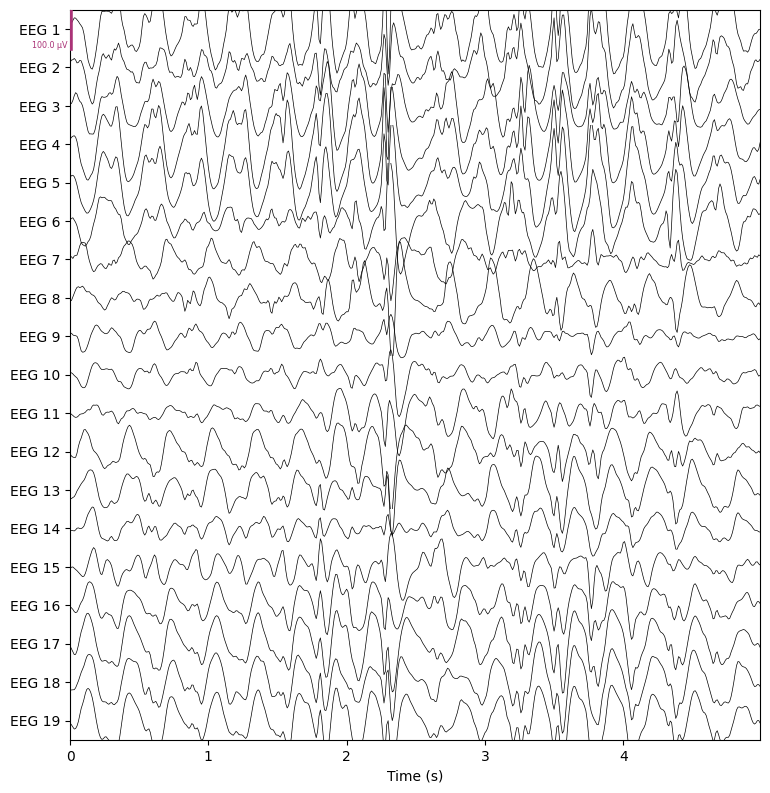

In [94]:
scalings = dict(eeg=500e-7)
p = raw.plot(duration=30, start=0,show_scrollbars=False, scalings=scalings)

In [95]:
mne.export.export_raw("test_eeg/6356_epi.set", raw, fmt="auto")

In [ ]:
5540

In [4]:
import mne

In [16]:
import numpy as np
import torch
from torch.nn.functional import cosine_similarity
import matplotlib.pyplot as plt
def sliding_window_segments(raw_data, segment_length, stride=8):
    num_channels, total_length = raw_data.shape
    if segment_length > total_length:
        raise ValueError("Segment length cannot be greater than the total length of the data.")
    if stride <= 0:
        raise ValueError("Stride must be a positive integer.")

    num_segments = (total_length - segment_length) // stride + 1

    # Создание скользящих окон
    windows = np.lib.stride_tricks.as_strided(
        raw_data,
        shape=(num_segments, num_channels, segment_length),
        strides=(raw_data.strides[1] * stride, raw_data.strides[0], raw_data.strides[1]),
    )

    return windows
def find_emb(eeg_data, model, segment_length, stride=1):
    # Генерация сегментов из всего сигнала
#     print(eeg_data)
    all_segments = sliding_window_segments(eeg_data, segment_length, stride)
    num_segments = all_segments.shape[0]

    # Вычисляем эмбеддинги для всех сегментов
    embeds = []
    batch_size = 64
    with torch.no_grad():
        for start_idx in range(0, num_segments, batch_size):
            # Формирование батча
            batch_segments = all_segments[start_idx:start_idx + batch_size]
            mean = batch_segments.mean(axis=-1)
            std = batch_segments.std(axis=-1)
            batch = (batch_segments - mean[:,:, np.newaxis]) / std[:,:, np.newaxis]
            batch_tensor = torch.tensor(batch).unsqueeze(1).float().to(mps_device) 
            # batch_tensor = torch.tensor(batch_segments).unsqueeze(1).float().to(mps_device)  # (Batch, 1, Channels, Segment Length)

            # Пропуск через модель
            batch_embeds = model(batch_tensor)
            
            embeds.extend(batch_embeds.cpu().numpy())
        if start_idx % 1024:
            print(start_idx)

    # Преобразуем данные для визуализации
    embeds = np.array(embeds)
    return embeds
    
def plot_eeg_with_similarity(eeg_data, plot_data, model, anomaly_segment, segment_length, stride=1):
    """
    Вычисляет косинусное расстояние эмбеддингов и строит график.

    Args:
        eeg_data (numpy.ndarray): Данные ЭЭГ формы (Channels, Time).
        model (torch.nn.Module): Обученная модель для получения эмбеддингов.
        anomaly_interval (tuple): Временной интервал (start, end) аномальной области.
        segment_length (int): Длина сегмента.
        stride (int): Шаг окна.

    Returns:
        None. Строит график сигнала и косинусных расстояний.
    """
    # Выделяем аномальную область
#     anomaly_start, anomaly_end = anomaly_interval
#     anomaly_segment = eeg_data[:, anomaly_start:anomaly_end]
    if anomaly_segment.shape[1] != segment_length:
        print(anomaly_segment.shape)
        raise ValueError("Аномальная область должна быть равна segment_length.")

    # Вычисляем эмбеддинг аномального сегмента
    model.eval()
    with torch.no_grad():
        anomaly_embed = model(torch.tensor(anomaly_segment).unsqueeze(0).unsqueeze(0).float().to(mps_device))

    # Генерация сегментов из всего сигнала
#     print(eeg_data)
    all_segments = sliding_window_segments(eeg_data, segment_length, stride)
    num_segments = all_segments.shape[0]

    # Вычисляем эмбеддинги для всех сегментов
    similarities = []
    batch_size = 64
    with torch.no_grad():
        for start_idx in range(0, num_segments, batch_size):
            # Формирование батча
            batch_segments = all_segments[start_idx:start_idx + batch_size]
            batch_tensor = torch.tensor(batch_segments).unsqueeze(1).float().to(mps_device)  # (Batch, 1, Channels, Segment Length)

            # Пропуск через модель
            batch_embeds = model(batch_tensor)  # (Batch, Embedding Dim)

            # Вычисление косинусного расстояния для батча
            batch_similarities = cosine_similarity(anomaly_embed, batch_embeds, dim=1)  # (Batch,)
            similarities.extend(batch_similarities.cpu().numpy())
        if start_idx % 1024:
            print(start_idx)

    # Преобразуем данные для визуализации
    similarities = np.array(similarities)
    time_axis = np.arange(len(similarities)) * stride

    # Построение графиков
    fig, axes = plt.subplots(2, 1, figsize=(15, 8), sharex=True)

    # График ЭЭГ
    scaling_factor = 1e6  # Масштабируем сигнал, если нужно
    for i, channel_data in enumerate(plot_data):
        axes[0].plot(channel_data * scaling_factor + i * 50)  # смещение для каждого канала

    
#     axes[0].axvspan(anomaly_start, anomaly_end, color='red', alpha=0.3, label="Anomalous Region")
#     axes[0].set_title("EEG Signal")
#     axes[0].legend()

    # График косинусного расстояния
    axes[1].plot(time_axis, similarities, label="Cosine Similarity", color="blue")
    axes[1].set_title("Cosine Distance")
    axes[1].set_xlabel("Time")
    axes[1].set_ylabel("Cosine Distance")
    axes[1].legend()

    plt.tight_layout()
    plt.savefig("example_norm.png")
    plt.show()
def find_similarity(eeg_data, plot_data, model, anomaly_segment, segment_length, stride=1):
    """
    Вычисляет косинусное расстояние эмбеддингов и строит график.

    Args:
        eeg_data (numpy.ndarray): Данные ЭЭГ формы (Channels, Time).
        model (torch.nn.Module): Обученная модель для получения эмбеддингов.
        anomaly_interval (tuple): Временной интервал (start, end) аномальной области.
        segment_length (int): Длина сегмента.
        stride (int): Шаг окна.

    Returns:
        None. Строит график сигнала и косинусных расстояний.
    """
    # Выделяем аномальную область
#     anomaly_start, anomaly_end = anomaly_interval
#     anomaly_segment = eeg_data[:, anomaly_start:anomaly_end]
    if anomaly_segment.shape[1] != segment_length:
        raise ValueError("Аномальная область должна быть равна segment_length.")

    # Вычисляем эмбеддинг аномального сегмента
    model.eval()
    with torch.no_grad():
        anomaly_embed = model(torch.tensor(anomaly_segment).unsqueeze(0).unsqueeze(0).float().to(mps_device))

    # Генерация сегментов из всего сигнала
#     print(eeg_data)
    

    # Вычисляем эмбеддинги для всех сегментов
    similarities = []
    batch_size = 64
    batch = []
    with torch.no_grad():
        for start_idx in range(0, eeg_data.shape[1]-segment_length):
            # Формирование батча
            if len(batch) == 64:
                batch = np.array(batch)
                batch_tensor = torch.tensor(batch).unsqueeze(1).float().to(mps_device)
                batch_embeds = model(batch_tensor)
                batch_similarities = cosine_similarity(anomaly_embed, batch_embeds, dim=1)  # (Batch,)
                similarities.extend(batch_similarities.cpu().numpy())
                batch = []
            batch.append(eeg_data[:, start_idx:start_idx+segment_length])
            if start_idx % 1024 == 0:
                print(start_idx)
            # Пропуск через модель
              # (Batch, Embedding Dim)

            # Вычисление косинусного расстояния для батча
            
        
    return similarities

In [7]:
eeg_data = test_raw_new.get_data()

In [8]:
eeg_data.shape

(19, 3671860)

In [34]:
eeg_data

array([[-9.75074388e-06, -9.15069810e-06, -8.95068284e-06, ...,
         5.34540780e-05,  4.66535592e-05,  3.59527428e-05],
       [-1.13508659e-05, -1.01507744e-05, -1.01507744e-05, ...,
         5.60542763e-05,  4.69535821e-05,  4.09531243e-05],
       [-7.15054551e-06, -6.05046159e-06, -3.95030137e-06, ...,
         2.16516518e-05,  1.79513695e-05,  1.38510567e-05],
       ...,
       [ 4.25032425e-06,  3.95030137e-06,  5.85044633e-06, ...,
        -1.67512779e-05, -1.48511330e-05, -1.54511788e-05],
       [ 8.65065995e-06,  6.35048447e-06,  5.05038529e-06, ...,
        -1.71513085e-05, -1.81513848e-05, -1.78513619e-05],
       [ 5.55042344e-06,  5.15039292e-06,  4.55034714e-06, ...,
        -1.79513695e-05, -1.86514229e-05, -1.89514458e-05]])

In [134]:
# Check that MPS is available
import torch
if not torch.backends.mps.is_available():
    if not torch.backends.mps.is_built():
        print("MPS not available because the current PyTorch install was not "
              "built with MPS enabled.")
    else:
        print("MPS not available because the current MacOS version is not 12.3+ "
              "and/or you do not have an MPS-enabled device on this machine.")

else:
    mps_device = torch.device("mps")

In [62]:
emb = find_emb(eeg_data[:,300000:400000], model, 256, stride=64)

1536


In [12]:
emb.shape

(4840, 128)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import DBSCAN
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler

def perform_dbscan_tsne(embeddings, eps=0.5, min_samples=5):
    """
    Выполняет кластеризацию DBSCAN и визуализирует результаты с помощью t-SNE.

    Args:
        embeddings (numpy.ndarray): Матрица эмбеддингов (num_samples, embedding_dim).
        eps (float): Параметр DBSCAN, радиус окрестности точки.
        min_samples (int): Минимальное количество точек в кластере.

    Returns:
        labels (numpy.ndarray): Метки кластеров для каждого эмбеддинга.
    """
    # Нормализация эмбеддингов
    embeddings = StandardScaler().fit_transform(embeddings)
    
    # Кластеризация DBSCAN
    dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric='euclidean')
    labels = dbscan.fit_predict(embeddings)
    
    # Визуализация t-SNE
    tsne = TSNE(n_components=2, perplexity=30, random_state=42)
    tsne_results = tsne.fit_transform(embeddings)
    
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x=tsne_results[:, 0], y=tsne_results[:, 1], hue=labels, palette='tab10', legend='full')
    plt.title("t-SNE Visualization of EEG Embeddings with DBSCAN Clusters")
    plt.xlabel("t-SNE Component 1")
    plt.ylabel("t-SNE Component 2")
    plt.show()
    
    return labels

def plot_eeg_clusters(eeg_data, labels, segment_length, stride=64):
    """
    Визуализирует исходные ЭЭГ данные с изменением фона в зависимости от кластера.

    Args:
        eeg_data (numpy.ndarray): Данные ЭЭГ формы (Channels, Time).
        labels (numpy.ndarray): Метки кластеров для каждого сегмента.
        segment_length (int): Длина сегмента.
        stride (int): Шаг окна.
    """
    time_axis = np.arange(len(labels)) * stride
    unique_labels = np.unique(labels)
    colors = plt.cm.tab10(np.linspace(0, 1, len(unique_labels)))
    label_color_map = {label: colors[i] for i, label in enumerate(unique_labels)}
    
    fig, ax = plt.subplots(figsize=(15, 5))
    for i, channel_data in enumerate(eeg_data):
        ax.plot(channel_data * 1000000 + i * 50, color='black', alpha=0.6)  # Смещение для каналов
    
    for idx, (start, label) in enumerate(zip(time_axis, labels)):
        ax.axvspan(start, start + segment_length, color=label_color_map[label], alpha=0.3)
    
    ax.set_title("EEG Signal with DBSCAN Clusters")
    ax.set_xlabel("Time")
    ax.set_ylabel("EEG Channels")
    plt.show()


/Users/egorperelygin/anaconda3/lib/python3.10/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


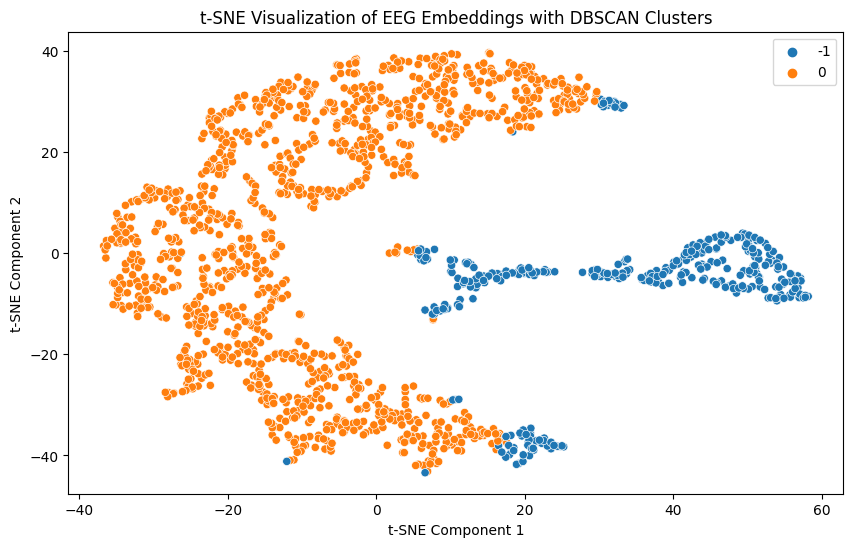

In [63]:
labels = perform_dbscan_tsne(emb, eps=0.05, min_samples=100)

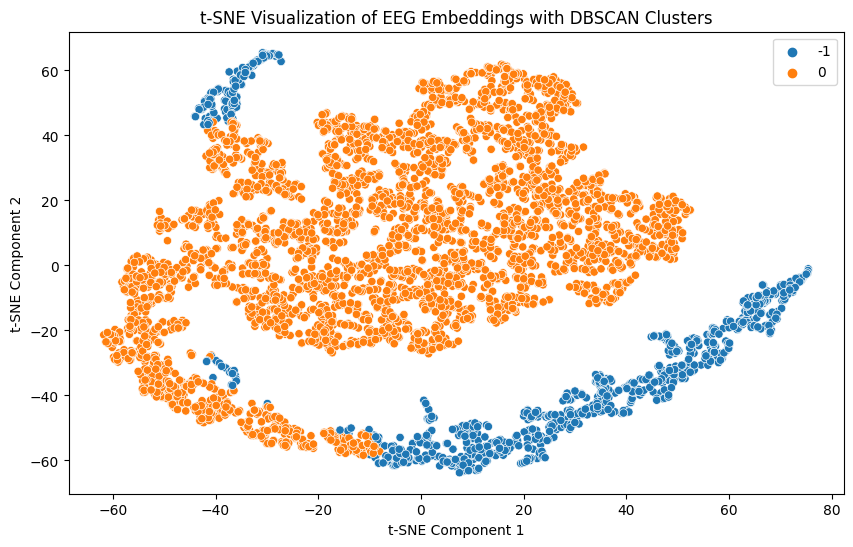

In [24]:
labels = perform_dbscan_tsne(emb, eps=0.5, min_samples=100)

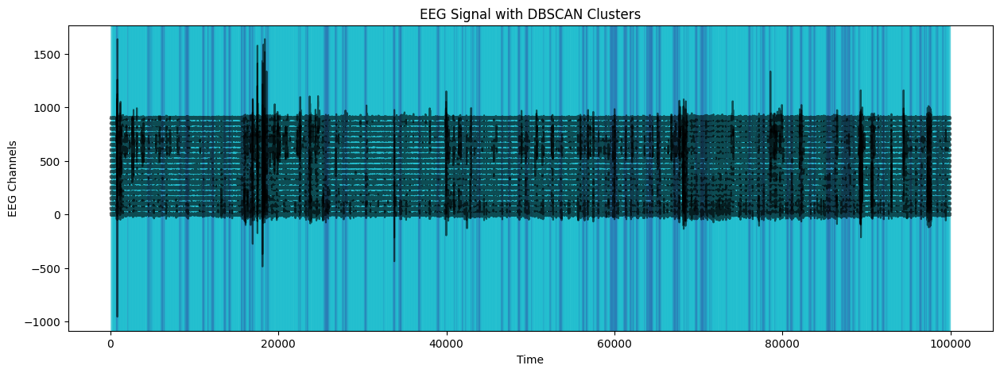

In [64]:
plot_eeg_clusters(eeg_data[:,300000:400000], labels, 256, stride=64)

In [131]:
import numpy as np
import torch
from torch.nn.functional import cosine_similarity
import matplotlib.pyplot as plt
def sliding_window_segments(raw_data, segment_length, stride=8):
    num_channels, total_length = raw_data.shape
    if segment_length > total_length:
        raise ValueError("Segment length cannot be greater than the total length of the data.")
    if stride <= 0:
        raise ValueError("Stride must be a positive integer.")

    num_segments = (total_length - segment_length) // stride + 1

    # Создание скользящих окон
    windows = np.lib.stride_tricks.as_strided(
        raw_data,
        shape=(num_segments, num_channels, segment_length),
        strides=(raw_data.strides[1] * stride, raw_data.strides[0], raw_data.strides[1]),
    )

    return windows
def plot_eeg_with_similarity(eeg_data, plot_data, model, anomaly_segment, segment_length, stride=1):
    """
    Вычисляет косинусное расстояние эмбеддингов и строит график.

    Args:
        eeg_data (numpy.ndarray): Данные ЭЭГ формы (Channels, Time).
        model (torch.nn.Module): Обученная модель для получения эмбеддингов.
        anomaly_interval (tuple): Временной интервал (start, end) аномальной области.
        segment_length (int): Длина сегмента.
        stride (int): Шаг окна.

    Returns:
        None. Строит график сигнала и косинусных расстояний.
    """
    # Выделяем аномальную область
#     anomaly_start, anomaly_end = anomaly_interval
#     anomaly_segment = eeg_data[:, anomaly_start:anomaly_end]
    if anomaly_segment.shape[1] != segment_length:
        print(anomaly_segment.shape)
        raise ValueError("Аномальная область должна быть равна segment_length.")

    # Вычисляем эмбеддинг аномального сегмента
    model.eval()
    with torch.no_grad():
        mean = anomaly_segment.mean(axis=-1)
        std = anomaly_segment.std(axis=-1)
        anomaly_segment = (anomaly_segment - mean[:, np.newaxis]) / std[:, np.newaxis]
        anomaly_embed = model(torch.tensor(anomaly_segment).unsqueeze(0).unsqueeze(0).float().to(mps_device))

    # Генерация сегментов из всего сигнала
#     print(eeg_data)
    all_segments = sliding_window_segments(eeg_data, segment_length, stride)
    num_segments = all_segments.shape[0]

    # Вычисляем эмбеддинги для всех сегментов
    similarities = []
    batch_size = 64
    with torch.no_grad():
        for start_idx in range(0, num_segments, batch_size):
            # Формирование батча
            batch_segments = all_segments[start_idx:start_idx + batch_size]
            mean = batch_segments.mean(axis=-1)
            std = batch_segments.std(axis=-1)
            batch = (batch_segments - mean[:,:, np.newaxis]) / std[:,:, np.newaxis]
            batch_tensor = torch.tensor(batch).unsqueeze(1).float().to(mps_device)  # (Batch, 1, Channels, Segment Length)

            # Пропуск через модель
            batch_embeds = model(batch_tensor)  # (Batch, Embedding Dim)

            # Вычисление косинусного расстояния для батча
            batch_similarities = cosine_similarity(anomaly_embed, batch_embeds, dim=1)  # (Batch,)
            similarities.extend(batch_similarities.cpu().numpy())
        if start_idx % 1024:
            print(start_idx)

    # Преобразуем данные для визуализации
    similarities = np.array(similarities)
    time_axis = np.arange(len(similarities)) * stride

    # Построение графиков
    fig, axes = plt.subplots(2, 1, figsize=(15, 8), sharex=True)

    # График ЭЭГ
    scaling_factor = 1e6  # Масштабируем сигнал, если нужно
    for i, channel_data in enumerate(plot_data):
        axes[0].plot(channel_data * scaling_factor + i * 50)  # смещение для каждого канала

    
#     axes[0].axvspan(anomaly_start, anomaly_end, color='red', alpha=0.3, label="Anomalous Region")
#     axes[0].set_title("EEG Signal")
#     axes[0].legend()

    # График косинусного расстояния
    axes[1].plot(time_axis, similarities, label="Cosine Similarity", color="blue")
    axes[1].set_title("Cosine Distance")
    axes[1].set_xlabel("Time")
    axes[1].set_ylabel("Cosine Distance")
    axes[1].legend()

    plt.tight_layout()
    plt.savefig("example_norm.png")
    plt.show()
    return anomaly_embed
def find_similarity(eeg_data, plot_data, model, anomaly_segment, segment_length, stride=1):
    """
    Вычисляет косинусное расстояние эмбеддингов и строит график.

    Args:
        eeg_data (numpy.ndarray): Данные ЭЭГ формы (Channels, Time).
        model (torch.nn.Module): Обученная модель для получения эмбеддингов.
        anomaly_interval (tuple): Временной интервал (start, end) аномальной области.
        segment_length (int): Длина сегмента.
        stride (int): Шаг окна.

    Returns:
        None. Строит график сигнала и косинусных расстояний.
    """
    # Выделяем аномальную область
#     anomaly_start, anomaly_end = anomaly_interval
#     anomaly_segment = eeg_data[:, anomaly_start:anomaly_end]
    if anomaly_segment.shape[1] != segment_length:
        raise ValueError("Аномальная область должна быть равна segment_length.")

    # Вычисляем эмбеддинг аномального сегмента
    model.eval()
    with torch.no_grad():
        anomaly_embed = model(torch.tensor(anomaly_segment).unsqueeze(0).unsqueeze(0).float().to(mps_device))

    # Генерация сегментов из всего сигнала
#     print(eeg_data)
    

    # Вычисляем эмбеддинги для всех сегментов
    similarities = []
    batch_size = 64
    batch = []
    with torch.no_grad():
        for start_idx in range(0, eeg_data.shape[1]-segment_length):
            # Формирование батча
            if len(batch) == 64:
                batch = np.array(batch)
                mean = batch.mean(axis=-1)
                std = batch.std(axis=-1)
                batch = (batch - mean[:,:, np.newaxis]) / std[:,:, np.newaxis]
                batch_tensor = torch.tensor(batch).unsqueeze(1).float().to(mps_device)
                batch_embeds = model(batch_tensor)
                batch_similarities = cosine_similarity(anomaly_embed, batch_embeds, dim=1)  # (Batch,)
                similarities.extend(batch_similarities.cpu().numpy())
                batch = []
            batch.append(eeg_data[:, start_idx:start_idx+segment_length])
            if start_idx % 1024 == 0:
                print(start_idx)
            # Пропуск через модель
              # (Batch, Embedding Dim)

            # Вычисление косинусного расстояния для батча
            
        
    return similarities

9984


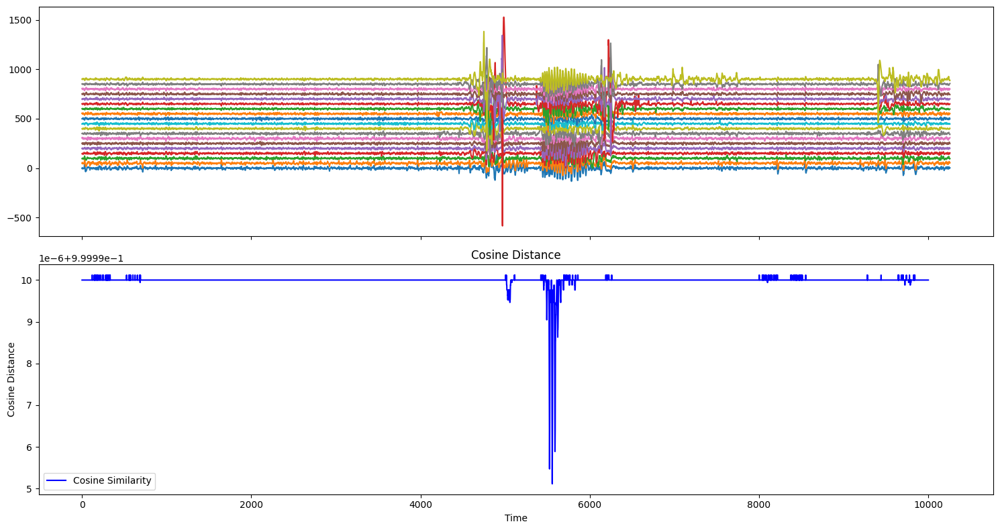

In [46]:
# plot_eeg_with_similarity(eeg_data_new[:,-15000:], model, eeg_data_new[:,145:145+128], segment_length, stride=1)
an1 = plot_eeg_with_similarity(eeg_data[:,250000:260000+256], eeg_data[:,250000:260000+256], model, eeg_data[:,250000:250000+256], 256, stride=1)
# score = find_similarity(eeg_data_new[:,90400:150400+256], eeg_data_new[:,90400:150400+256], model, eeg_

In [30]:
score = find_similarity(eeg_data[:,250000:260000+256], eeg_data[:,250000:260000+256], model, eeg_data[:,250000:250000+256], 256, stride=1)

0
1024
2048
3072
4096
5120
6144
7168
8192
9216


In [31]:
score

[1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0000001,
 1.0000001,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0000001,
 1.0,
 1.0,
 1.0000001,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0000001,
 1.0000001,
 1.0000001,
 1.0,
 1.0,
 1.0,
 1.0

9984


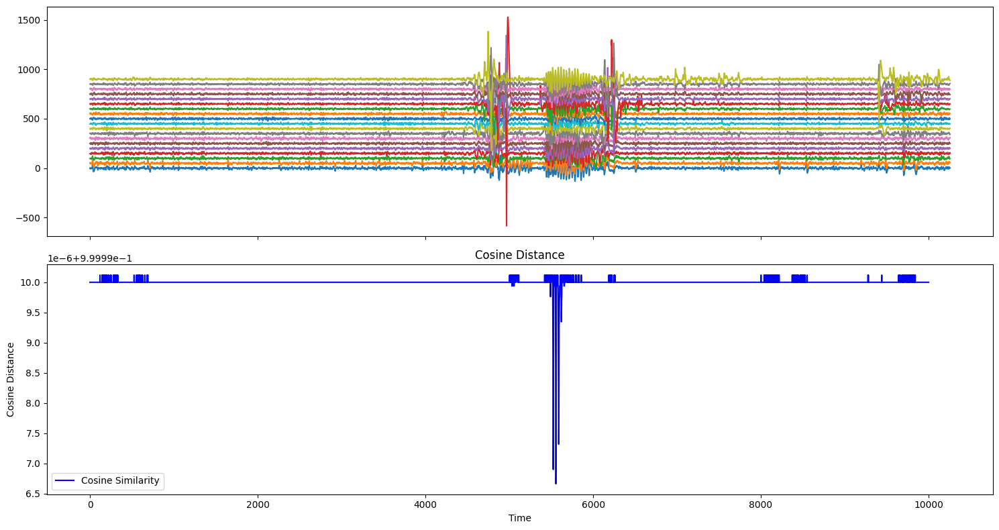

In [47]:
an2 = plot_eeg_with_similarity(eeg_data[:,250000:260000+256], eeg_data[:,250000:260000+256], model, eeg_data[:,255500:255500+256], 256, stride=1)

In [48]:
an2-an1

tensor([[ 0.0000e+00,  0.0000e+00,  0.0000e+00, -5.1692e-06,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00, -1.0602e-04,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00, -3.4943e-06, -4.3276e-06,
          0.0000e+00,  0.0000e+00, -5.9682e-05,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00, -1.2127e-06,  0.0000e+00,  1.5315e-05,
          3.2163e-06,  0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  3.3117e-07, -2.9509e-06,  1.4205e-06,  0.0000e+00,
          1.4252e-07, -5.3657e-07,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00, -3.1422e-07,
          0.0000e+00,  0.0000e+00,  0.0000e+00,  6.7387e-07,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.

In [35]:
an1

tensor([[-2.1189e-08, -2.0052e-08, -2.3741e-08,  5.8934e-06,  4.8759e-08,
         -1.9257e-08, -2.5657e-08,  1.0607e-08, -1.2507e-08, -2.0385e-08,
         -1.8212e-08,  1.8731e-04, -1.9961e-08, -1.9672e-08, -1.9803e-08,
         -2.0062e-08, -1.6557e-08, -1.9961e-08, -1.3966e-08, -1.6557e-08,
         -2.5861e-08, -2.1561e-08, -4.0034e-07,  1.5022e-05,  4.1107e-06,
         -7.3568e-09, -1.8949e-08,  4.8267e-05, -1.6557e-08, -5.4457e-05,
         -1.6259e-08, -1.9527e-08,  2.0048e-06, -2.0072e-08, -1.6413e-05,
         -3.4536e-06,  4.2346e-09, -2.0419e-08, -1.7654e-08, -1.6557e-08,
         -1.9962e-08,  1.3664e-07,  2.4479e-06, -1.4316e-06, -1.9594e-08,
         -4.5739e-07, -3.3975e-07, -1.9879e-08, -1.9568e-08, -1.6413e-08,
         -1.9776e-08, -1.9961e-08, -1.6491e-08, -1.9568e-08,  1.5021e-07,
          9.5908e-08, -1.8158e-08, -1.6424e-08, -1.2017e-06, -1.9683e-08,
         -2.3619e-08, -1.9175e-08, -1.9568e-08, -1.8329e-08, -1.6259e-08,
         -1.6525e-08, -1.6830e-08, -2.

In [54]:
model.eval()
anomaly_segment = eeg_data[:,250000:250000+256]
with torch.no_grad():
    mean = anomaly_segment.mean(axis=-1)
    std = anomaly_segment.std(axis=-1)
    anomaly_segment = (anomaly_segment - mean[:, np.newaxis]) / std[:, np.newaxis]
    anomaly_embed = model(torch.tensor(anomaly_segment).unsqueeze(0).unsqueeze(0).float().to(mps_device))

In [50]:
anomaly_segment.shape

(19, 256)

In [51]:
mean.shape

(19,)

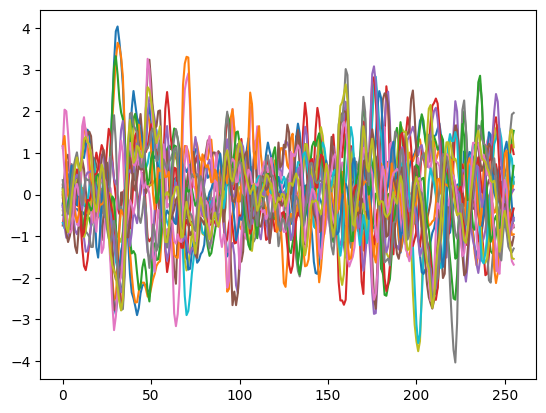

In [55]:
plt.plot(anomaly_segment.T)

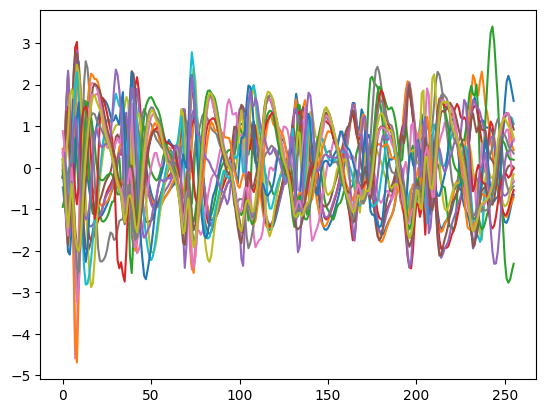

In [53]:
plt.plot(anomaly_segment.T)

In [152]:
raw = mne.io.read_raw_eeglab('/Users/egorperelygin/уупууп/123ЭПИ050125_ann_thr=02.set', preload=True)

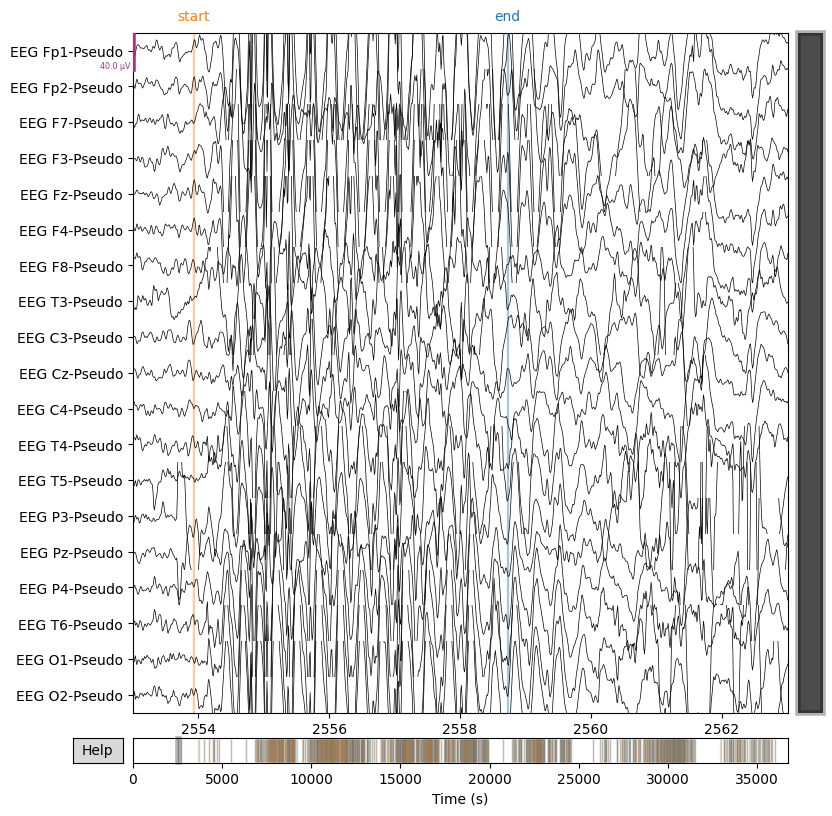

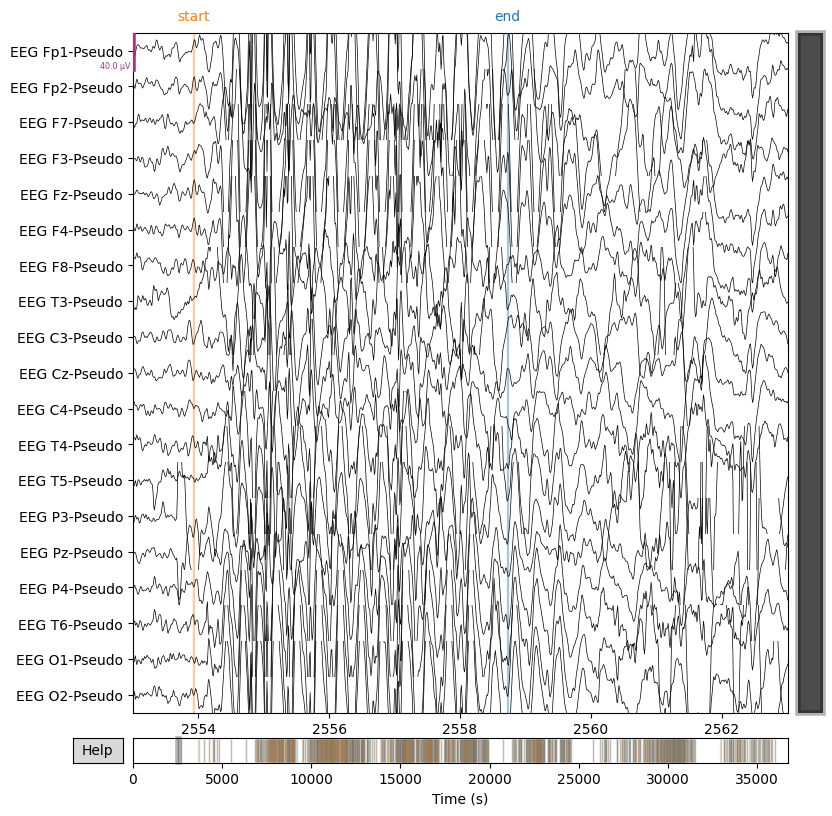

In [155]:
raw.plot(start=2553)

In [25]:
import os
import mne  # Для работы с .set файлами
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split


class NormalizeWindow:
    """
    Нормализует каждое окно отдельно: центрирование и масштабирование.
    """

    def __call__(self, eeg_window):
        mean = np.mean(eeg_window, axis=1, keepdims=True)  # Среднее по каждому каналу
        std = np.std(eeg_window, axis=1, keepdims=True)
        return (eeg_window - mean) / std


class TripletEEGDataset(Dataset):
    def __init__(self, files, labels, segment_length=128, stride=64, transform=None):
        """
        Датасет для триплет-обучения на основе EEG данных.

        :param files: Список путей к файлам .set.
        :param labels: Метки классов (0 - норм, 1 - эпилепсия).
        :param segment_length: Длина сегмента в отсчетах (по ширине).
        :param transform: Аугментации (если применяются).
        """
        self.files = files
        self.labels = labels
        self.segment_length = segment_length
        self.transform = transform if transform else NormalizeWindow()

        # Предобработка: загружаем данные
        self.data = []
        self.data_labels = []
        for file, label in zip(files, labels):
            eeg_data = self._load_eeg(file, stride=stride)
            self.data.append(eeg_data)
            self.data_labels.append([label] * len(eeg_data))

        self.data = np.concatenate(self.data, axis=0)
        self.data_labels = np.concatenate(self.data_labels, axis=0)

        # Группировка индексов по классам
        self.label_to_indices = {
            label: np.where(self.data_labels == label)[0]
            for label in np.unique(self.data_labels)
        }

    def sliding_window_segments(self, raw_data, segment_length, stride=64):
        num_channels, total_length = raw_data.shape
        if segment_length > total_length:
            raise ValueError("Segment length cannot be greater than the total length of the data.")
        if stride <= 0:
            raise ValueError("Stride must be a positive integer.")

        num_segments = (total_length - segment_length) // stride + 1

        # Создание скользящих окон
        windows = np.lib.stride_tricks.as_strided(
            raw_data,
            shape=(num_segments, num_channels, segment_length),
            strides=(raw_data.strides[1] * stride, raw_data.strides[0], raw_data.strides[1]),
        )

        return windows

    def _load_eeg(self, file, stride):
        """
        Загружает и обрабатывает EEG из файла .set.
        """
        raw = mne.io.read_raw_eeglab(file, preload=True)
        raw_data = raw.get_data()  # Данные в формате (каналы, временные точки)
        segmented_data = self.sliding_window_segments(raw_data, self.segment_length, stride=stride)
        return segmented_data

    def __getitem__(self, index):
        # Anchor
        anchor = self.transform(self.data[index])
        anchor_label = self.data_labels[index]

        # Positive
        positive_index = np.random.choice(self.label_to_indices[anchor_label])
        while positive_index == index:
            positive_index = np.random.choice(self.label_to_indices[anchor_label])
        positive = self.transform(self.data[positive_index])

        # Negative
        negative_label = 1 - anchor_label
        negative_index = np.random.choice(self.label_to_indices[negative_label])
        negative = self.transform(self.data[negative_index])

        return (
            torch.tensor(anchor, dtype=torch.float32).unsqueeze(0),
            torch.tensor(positive, dtype=torch.float32).unsqueeze(0),
            torch.tensor(negative, dtype=torch.float32).unsqueeze(0), 
            torch.tensor(anchor_label, dtype=torch.long)
        )

    def __len__(self):
        return len(self.data)


# Разделение файлов на тренировочные и валидационные
def create_datasets(folder, segment_length=128):
    # Читаем все файлы
    all_files = [f for f in os.listdir(folder) if f.endswith(".set")]
    epi_files = [os.path.join(folder, f) for f in all_files if f.endswith("epi.set")]
    norm_files = [os.path.join(folder, f) for f in all_files if f.endswith("norm.set")]
    print(len(epi_files), len(norm_files))

    # Подготовка данных
    # train_files = epi_files[:-2] + norm_files[:-2]
    # train_labels = [1] * (len(epi_files)-2) + [0] * (len(norm_files)-2)
    # val_files = epi_files[-2:] + norm_files[-2:]
    # val_labels = [1,1] + [0,0]
    val_files = epi_files + norm_files
    val_labels = [1] * (len(epi_files)) + [0] * (len(norm_files))
    # Создаем датасеты
    # train_dataset = TripletEEGDataset(train_files, train_labels, segment_length, stride=32)
    val_dataset = TripletEEGDataset(val_files, val_labels, segment_length, stride=16)

    # return train_dataset, val_dataset
    return val_dataset

/Users/egorperelygin/anaconda3/lib/python3.10/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


In [120]:
# Укажите путь к папке с файлами .set
folder_path = "/Users/egorperelygin/test_eeg"
# folder_path = "/Users/egorperelygin/eeg_train"
# Создаем тренировочный и валидационный датасеты
segment_length = 256  # Гиперпараметр (длина сегмента)
val_dataset = create_datasets(folder_path, segment_length)
# train_dataset, val_dataset = create_datasets(folder_path, segment_length)
# DataLoader
# train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)
print(len(val_dataset))
print(len(train_dataset))
# Пример итерации
for anchor, positive, negative, l in train_loader:
    print("Anchor shape:", anchor.shape)
    print("Positive shape:", positive.shape)
    print("Negative shape:", negative.shape)
    break

9 9
719
43328
Anchor shape: torch.Size([32, 1, 19, 256])
Positive shape: torch.Size([32, 1, 19, 256])
Negative shape: torch.Size([32, 1, 19, 256])


In [117]:
import os
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
import matplotlib.animation as animation
from IPython.display import HTML

# Путь к папке с моделями
models_dir = "hard_metric"  # Укажите путь к папке с моделями
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Найдём все файлы моделей resnet18_{epoch}.pth
model_files = sorted(
    [f for f in os.listdir(models_dir)],
    key=lambda x: int(x.split("_")[1])  # Сортируем по номеру эпохи
)

# Список эпох
epochs = [int(f.split("_")[1]) for f in model_files]

# Словарь для хранения t-SNE данных
tsne_results_dict = {}

for model_file in model_files:
    # Извлекаем номер эпохи
    epoch = int(model_file.split("_")[1].split(".")[0])

    # Загружаем модель
    model_path = os.path.join(models_dir, model_file)
    model = torch.load(model_path, map_location=device)
    model.eval()

    emb = []
    labels = []

    # Вычисляем эмбеддинги
    for anchor, _, _, lab in val_loader:
        anchor = anchor.to(device)

        with torch.no_grad():
            anchor_embed = model(anchor)
        
        emb.append(anchor_embed.cpu().numpy())
        labels.append(lab.numpy())

    # Преобразуем списки в массивы
    new_emb = np.vstack(emb)
    new_lab = np.concatenate(labels)*10

    # Нормализация эмбеддингов
    embeddings = StandardScaler().fit_transform(new_emb)

    # Вычисляем t-SNE
    tsne = TSNE(n_components=2, perplexity=30, random_state=42)
    tsne_results = tsne.fit_transform(embeddings)

    # Сохраняем результат
    tsne_results_dict[epoch] = (tsne_results, new_lab)

# --- Создание анимации ---
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlabel("t-SNE Component 1")
ax.set_ylabel("t-SNE Component 2")
ax.set_title("t-SNE Visualization")

# Создаём пустой график
scatter = ax.scatter([], [], c=[], cmap="tab10", edgecolor="k")

def animate(epoch):
    ax.clear()
    tsne_results, new_lab = tsne_results_dict[epoch]

    scatter = ax.scatter(
        tsne_results[:, 0], tsne_results[:, 1], c=new_lab, cmap="tab10", edgecolor="k"
    )
    
    ax.set_xlabel("t-SNE Component 1")
    ax.set_ylabel("t-SNE Component 2")
    ax.set_title(f"t-SNE Visualization - Epoch {epoch}")
    
    return scatter,

# Создаём анимацию
anim = animation.FuncAnimation(fig, animate, frames=epochs, interval=1000)
plt.close()
HTML(anim.to_jshtml())



In [ ]:
вал триплет хардмайнинг

In [114]:
import os
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
import matplotlib.animation as animation
from IPython.display import HTML

# Путь к папке с моделями
models_dir = "hard_metric"  # Укажите путь к папке с моделями
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Найдём все файлы моделей resnet18_{epoch}.pth
model_files = sorted(
    [f for f in os.listdir(models_dir)],
    key=lambda x: int(x.split("_")[1])  # Сортируем по номеру эпохи
)

# Список эпох
epochs = [int(f.split("_")[1]) for f in model_files]

# Словарь для хранения t-SNE данных
tsne_results_dict = {}

for model_file in model_files:
    # Извлекаем номер эпохи
    epoch = int(model_file.split("_")[1].split(".")[0])

    # Загружаем модель
    model_path = os.path.join(models_dir, model_file)
    model = torch.load(model_path, map_location=device)
    model.eval()

    emb = []
    labels = []

    # Вычисляем эмбеддинги
    for anchor, _, _, lab in val_loader:
        anchor = anchor.to(device)

        with torch.no_grad():
            anchor_embed = model(anchor)
        
        emb.append(anchor_embed.cpu().numpy())
        labels.append(lab.numpy())

    # Преобразуем списки в массивы
    new_emb = np.vstack(emb)
    new_lab = np.concatenate(labels)*10

    # Нормализация эмбеддингов
    embeddings = StandardScaler().fit_transform(new_emb)

    # Вычисляем t-SNE
    tsne = TSNE(n_components=2, perplexity=30, random_state=42)
    tsne_results = tsne.fit_transform(embeddings)

    # Сохраняем результат
    tsne_results_dict[epoch] = (tsne_results, new_lab)

# --- Создание анимации ---
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlabel("t-SNE Component 1")
ax.set_ylabel("t-SNE Component 2")
ax.set_title("t-SNE Visualization")

# Создаём пустой график
scatter = ax.scatter([], [], c=[], cmap="tab10", edgecolor="k")

def animate(epoch):
    ax.clear()
    tsne_results, new_lab = tsne_results_dict[epoch]

    scatter = ax.scatter(
        tsne_results[:, 0], tsne_results[:, 1], c=new_lab, cmap="tab10", edgecolor="k"
    )
    
    ax.set_xlabel("t-SNE Component 1")
    ax.set_ylabel("t-SNE Component 2")
    ax.set_title(f"t-SNE Visualization - Epoch {epoch}")
    
    return scatter,

# Создаём анимацию
anim = animation.FuncAnimation(fig, animate, frames=epochs, interval=1000)
plt.close()
HTML(anim.to_jshtml())


In [ ]:
тест триплет хардмайнинг

In [118]:
import os
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
import matplotlib.animation as animation
from IPython.display import HTML

# Путь к папке с моделями
models_dir = "angular_hard"  # Укажите путь к папке с моделями
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Найдём все файлы моделей resnet18_{epoch}.pth
model_files = sorted(
    [f for f in os.listdir(models_dir)],
    key=lambda x: int(x.split("_")[1])  # Сортируем по номеру эпохи
)

# Список эпох
epochs = [int(f.split("_")[1]) for f in model_files]

# Словарь для хранения t-SNE данных
tsne_results_dict = {}

for model_file in model_files:
    # Извлекаем номер эпохи
    epoch = int(model_file.split("_")[1].split(".")[0])

    # Загружаем модель
    model_path = os.path.join(models_dir, model_file)
    model = torch.load(model_path, map_location=device)
    model.eval()

    emb = []
    labels = []

    # Вычисляем эмбеддинги
    for anchor, _, _, lab in val_loader:
        anchor = anchor.to(device)

        with torch.no_grad():
            anchor_embed = model(anchor)
        
        emb.append(anchor_embed.cpu().numpy())
        labels.append(lab.numpy())

    # Преобразуем списки в массивы
    new_emb = np.vstack(emb)
    new_lab = np.concatenate(labels)*10

    # Нормализация эмбеддингов
    embeddings = StandardScaler().fit_transform(new_emb)

    # Вычисляем t-SNE
    tsne = TSNE(n_components=2, perplexity=30, random_state=42)
    tsne_results = tsne.fit_transform(embeddings)

    # Сохраняем результат
    tsne_results_dict[epoch] = (tsne_results, new_lab)

# --- Создание анимации ---
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlabel("t-SNE Component 1")
ax.set_ylabel("t-SNE Component 2")
ax.set_title("t-SNE Visualization")

# Создаём пустой график
scatter = ax.scatter([], [], c=[], cmap="tab10", edgecolor="k")

def animate(epoch):
    ax.clear()
    tsne_results, new_lab = tsne_results_dict[epoch]

    scatter = ax.scatter(
        tsne_results[:, 0], tsne_results[:, 1], c=new_lab, cmap="tab10", edgecolor="k"
    )
    
    ax.set_xlabel("t-SNE Component 1")
    ax.set_ylabel("t-SNE Component 2")
    ax.set_title(f"t-SNE Visualization - Epoch {epoch}")
    
    return scatter,

# Создаём анимацию
anim = animation.FuncAnimation(fig, animate, frames=epochs, interval=1000)
plt.close()
HTML(anim.to_jshtml())

In [ ]:
вал ангуляр хардмайнинг

In [122]:
import os
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
import matplotlib.animation as animation
from IPython.display import HTML

# Путь к папке с моделями
models_dir = "angular_hard"  # Укажите путь к папке с моделями
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Найдём все файлы моделей resnet18_{epoch}.pth
model_files = sorted(
    [f for f in os.listdir(models_dir)],
    key=lambda x: int(x.split("_")[1])  # Сортируем по номеру эпохи
)

# Список эпох
epochs = [int(f.split("_")[1]) for f in model_files]

# Словарь для хранения t-SNE данных
tsne_results_dict = {}

for model_file in model_files:
    # Извлекаем номер эпохи
    epoch = int(model_file.split("_")[1].split(".")[0])

    # Загружаем модель
    model_path = os.path.join(models_dir, model_file)
    model = torch.load(model_path, map_location=device)
    model.eval()

    emb = []
    labels = []

    # Вычисляем эмбеддинги
    for anchor, _, _, lab in val_loader:
        anchor = anchor.to(device)

        with torch.no_grad():
            anchor_embed = model(anchor)
        
        emb.append(anchor_embed.cpu().numpy())
        labels.append(lab.numpy())

    # Преобразуем списки в массивы
    new_emb = np.vstack(emb)
    new_lab = np.concatenate(labels)*10

    # Нормализация эмбеддингов
    embeddings = StandardScaler().fit_transform(new_emb)

    # Вычисляем t-SNE
    tsne = TSNE(n_components=2, perplexity=30, random_state=42)
    tsne_results = tsne.fit_transform(embeddings)

    # Сохраняем результат
    tsne_results_dict[epoch] = (tsne_results, new_lab)

# --- Создание анимации ---
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlabel("t-SNE Component 1")
ax.set_ylabel("t-SNE Component 2")
ax.set_title("t-SNE Visualization")

# Создаём пустой график
scatter = ax.scatter([], [], c=[], cmap="tab10", edgecolor="k")

def animate(epoch):
    ax.clear()
    tsne_results, new_lab = tsne_results_dict[epoch]

    scatter = ax.scatter(
        tsne_results[:, 0], tsne_results[:, 1], c=new_lab, cmap="tab10", edgecolor="k"
    )
    
    ax.set_xlabel("t-SNE Component 1")
    ax.set_ylabel("t-SNE Component 2")
    ax.set_title(f"t-SNE Visualization - Epoch {epoch}")
    
    return scatter,

# Создаём анимацию
anim = animation.FuncAnimation(fig, animate, frames=epochs, interval=1000)
plt.close()
HTML(anim.to_jshtml())

In [ ]:
тест ангуляр хардмайнинг

In [150]:
import os
import mne
import numpy as np

# Папка с .set файлами
data_dir = "test_eeg"

# Список всех .set файлов
set_files = [f for f in os.listdir(data_dir) if f.endswith(".set")]

# Списки для хранения объединенных данных, аннотаций и меток
raw_list = []
annotations = []
labels_all = []

# Частота дискретизации (будет взята из первого файла)
sfreq = None

for file in set_files:
    filepath = os.path.join(data_dir, file)

    # Загружаем файл
    raw = mne.io.read_raw_eeglab(filepath, preload=True)
    
    # Определяем метку
    label = 1 if "epi" in file else 0

    # Получаем частоту дискретизации
    if sfreq is None:
        sfreq = raw.info["sfreq"]

    # Создаем аннотации на весь файл
    duration = raw.get_data().shape[-1]  # Длительность в секундах
    num_labels = int(duration)  # Количество меток по частоте дискретизации

    onset = np.arange(0, duration, 1 / sfreq)  # Таймстампы
    description = [label] * num_labels  # Метки
    
    # annot = mne.Annotations(onset=onset, duration=[1/sfreq] * num_labels, description=description)
    # raw.set_annotations(annot)

    # Добавляем в список
    raw_list.append(raw)

    # Сохраняем метки для текущего файла
    labels_all.append(np.array([label] * num_labels))  # Массив меток

# Объединяем все файлы
raw_combined = mne.concatenate_raws(raw_list)

# Сохраняем объединенные данные
output_path = "merged_data.set"
mne.export.export_raw(output_path, raw_combined, fmt="auto", overwrite=True)

# Сохраняем метки в .npy файл
labels_all = np.concatenate(labels_all)  # Объединяем все метки
labels_output_path = "labels.npy"
np.save(labels_output_path, labels_all)

print(f"Объединенный файл сохранен в {output_path}")
print(f"Метки сохранены в {labels_output_path}")


Overwriting existing file.
Объединенный файл сохранен в merged_data.set
Метки сохранены в labels.npy


In [130]:
test_raw = mne.io.read_raw_eeglab('merged_data.set',preload=True)

In [132]:
eeg_data = test_raw.get_data()

In [138]:
model = torch.load('angular_hard/resnet18_19_0.9810979531110163_0.8299749223870173.pt')

15680


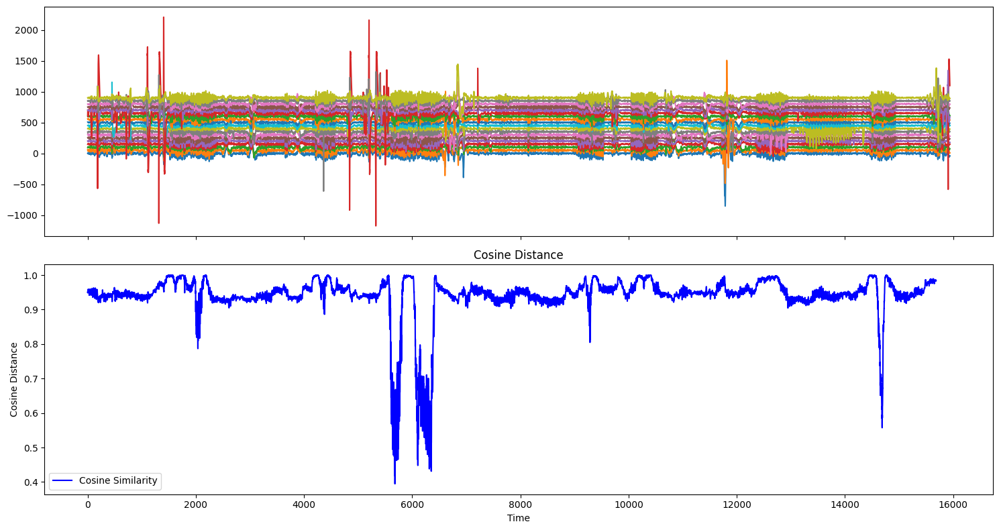

In [139]:
an1 = plot_eeg_with_similarity(eeg_data, eeg_data, model, eeg_data[:,1500:1500+256], 256, stride=1)

In [ ]:
import mne
import numpy as np
import torch
from torch.utils.data import Dataset

class NormalizeWindow:
    def __call__(self, eeg_window):
        mean = np.mean(eeg_window, axis=1, keepdims=True)
        std = np.std(eeg_window, axis=1, keepdims=True)
        return (eeg_window - mean) / (std + 1e-6)  # Избегаем деления на 0

class TripletEEGDataset(Dataset):
    def __init__(self, data, labels_file, segment_length=128, stride=64, transform=None):
        
        self.segment_length = segment_length
        self.transform = transform if transform else NormalizeWindow()
        self.stride = stride
        self.segment_length = segment_length
        self.data = data
        self. labels = np.zeros((self.data.shape[1]))
        self.labels[0] = 1
        self.labels[-1] = 1
        # Группировка индексов по классам
        self.label_to_indices = {
            label: np.where(self.labels == label)[0]
            for label in np.unique(self.labels)
        }

    def sliding_window_segments(self, raw_data, labels, segment_length, stride):
        """Разбивает EEG-данные и метки на окна."""
        num_channels, total_length = raw_data.shape
        num_segments = (total_length - segment_length) // stride + 1

        windows = np.array([
            raw_data[:, i:i+segment_length] for i in range(0, total_length - segment_length + 1, stride)
        ])
        window_labels = np.array([
            labels[i:i+segment_length].max() for i in range(0, total_length - segment_length + 1, stride)
        ])  # Берем метку как макс. значение в окне (если есть "1" в окне, оно эпилептическое)
        
        return windows, window_labels

    def __getitem__(self, index):

        anchor = self.data[:, index*self.stride:index*self.stride + self.segment_length]
        anchor = self.transform(anchor)
        
        return torch.tensor(anchor, dtype=torch.float32).unsqueeze(0)
        

    def __len__(self):
        return (self.data.shape[1] - self.segment_length) // self.stride + 1


In [151]:
dataset = TripletEEGDataset("merged_data.set", "labels.npy", segment_length=256, stride=8)


15940 15940


In [153]:
1500 // 8

187

In [52]:
import matplotlib.pyplot as plt
from scipy.spatial.distance import cosine

def create_dataloader(set_file, labels_file, batch_size=32, segment_length=128, stride=64):
    dataset = TripletEEGDataset(set_file, labels_file, segment_length, stride)
    print(len(dataset))
    return DataLoader(dataset, batch_size=batch_size, shuffle=False)


def compute_distances(embeddings, anomaly_idx):
    anomaly_embedding = embeddings[anomaly_idx]
    # print(embeddings.shape)
    l2_distances = np.linalg.norm(embeddings - anomaly_embedding, axis=(1))
    # print(l2_distances.shape)
    cosine_distances = np.array([cosine(embeddings[i].flatten(), anomaly_embedding.flatten()) for i in range(len(embeddings))])
    # print(cosine_distances.shape)
    return l2_distances, cosine_distances


def plot_eeg_and_distances(eeg_data, labels, l2_distances, cosine_distances, anomalous_segment_idx):
    fig, axes = plt.subplots(3, 1, figsize=(10, 9))
    time = np.arange(eeg_data.shape[0])
    
    axes[0].plot(time, eeg_data[:, 0, :].mean(axis=1), label='EEG')
    axes[0].scatter(time[labels == 1], eeg_data[labels == 1, 0, :].mean(axis=1), color='red', label='Anomaly')
    axes[0].set_title("EEG Signal with Anomalies")
    axes[0].legend()
    
    axes[1].plot(time, l2_distances, label='L2 Distance')
    axes[1].axvline(anomalous_segment_idx, color='red', linestyle='--', label='Anomalous Segment')
    axes[1].set_title("L2 Distance from Anomalous Segment")
    axes[1].legend()
    
    axes[2].plot(time, cosine_distances, label='Cosine Distance')
    axes[2].axvline(anomalous_segment_idx, color='red', linestyle='--', label='Anomalous Segment')
    axes[2].set_title("Cosine Distance from Anomalous Segment")
    axes[2].legend()
    
    plt.show()

In [156]:
raw_data.shape

(19, 3671860)

In [54]:
3671860 / 128

28686.40625

In [55]:
28686 / 897


31.97993311036789

In [48]:
28686 * 256

7343616

In [180]:
raw_data.shape

(19, 150358)

In [ ]:
def plot_eeg_and_distances(eeg_data, labels, l2_distances, cosine_distances, anomalous_segment_idx, ):
    fig, axes = plt.subplots(3, 1, figsize=(10, 9))
    
    # Временная шкала
    time = np.arange(raw_data.shape[1]) / 100

    # 1. График EEG сигнала
    axes[0].plot(time, eeg_data[-1, :], label='EEG')  # Среднее по каналам
    axes[0].scatter(time[labels == 1], eeg_data[0, labels == 1], color='red', label='Anomaly')
    axes[0].set_title("EEG Signal with Anomalies")
    axes[0].legend()

    time = np.arange(l2_distances.shape[0]) / 100 * 4
    # 2. L2 расстояния
    axes[1].plot(time, l2_distances, label='L2 Distance')
    axes[1].axvline(time[anomalous_segment_idx], color='red', linestyle='--', label='Anomalous Segment')
    axes[1].set_title("L2 Distance from Anomalous Segment")
    axes[1].legend()

    # 3. Косинусное расстояние
    axes[2].plot(time, cosine_distances, label='Cosine Distance')
    axes[2].axvline(time[anomalous_segment_idx], color='red', linestyle='--', label='Anomalous Segment')
    axes[2].set_title("Cosine Distance from Anomalous Segment")
    axes[2].legend()

    plt.show()

In [ ]:
segment_length=256
stride=4
dataloader = create_dataloader(raw_data, "labels.npy", segment_length=segment_length, stride=stride)
print(len(dataloader))


embeddings = []
eeg_segments = []
# labels = []
# segment_starts = []  # Временные индексы начала сегментов

current_time = 0  # Текущая временная точка
model=torch.load('hard_metric/resnet18_19_0.9992762047381143_0.9926679123594849.pt')
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
model.eval()
count = 0
for anchor in dataloader:
    if count % 1000 == 0:
        print(count)
    count += 1
    
    anchor = anchor.to(device)
    embs = model(anchor)
    embeddings.append(embs.detach().cpu().numpy())



37526
1173
0
1000


In [106]:
def detect_anomalies(probabilities, threshold, margin=0.05, window_size=256, stride=32):
    anomalies = []
    start = None

    for idx, prob in enumerate(probabilities):
        i = idx * stride  # Текущее реальное смещение
        if prob < threshold:
            if start is None:
                start = i
        else:
            if start is not None and prob > threshold + margin:
                if i - start >= window_size - stride:  # Учитываем stride при проверке длины
                    anomalies.append((start, i + window_size))
                    start = None

    if start is not None:
        anomalies.append((start, (len(probabilities) - 1) * stride + window_size))

    return anomalies


def merge_overlapping_segments(segments):
    if not segments:
        return []
    
    # Сортируем сегменты по началу
    segments.sort(key=lambda x: x[0])
    merged = [segments[0]]
    
    for current in segments[1:]:
        previous = merged[-1]
        # Если текущий сегмент пересекается или соприкасается с предыдущим
        if current[0] <= previous[1]:
            # Объединяем сегменты
            merged[-1] = (previous[0], max(previous[1], current[1]))
        else:
            # Добавляем как новый сегмент
            merged.append(current)
    
    return merged


In [266]:
34900 / 4

8725.0

In [ ]:
475 578 

11887.5

In [257]:
anomaly_segments = []

In [ ]:
embeddings1 = np.concatenate(embeddings, axis=0)
print(embeddings1.shape)
# Выбираем индекс первого аномального сегмента
anomalous_segment_idx = 8725

# Вычисляем расстояния
l2_distances, cosine_distances = compute_distances(embeddings1, anomalous_segment_idx)


(37526, 128)


In [268]:
an_seg = detect_anomalies(l2_distances, 0.2, margin=0.05, window_size=256, stride=4)

In [272]:
len(anomaly_segments)

3

In [271]:
anomaly_segments.append(merge_overlapping_segments(an_seg))

In [273]:
def intersect_intervals(intervals1, intervals2):
    """Находит пересечение двух списков интервалов"""
    result = []
    i = j = 0

    while i < len(intervals1) and j < len(intervals2):
        a_start, a_end = intervals1[i]
        b_start, b_end = intervals2[j]

        # Находим пересечение
        start = max(a_start, b_start)
        end = min(a_end, b_end)

        if start < end:  # Есть пересечение
            result.append([start, end])

        # Продвигаемся по тому интервалу, который заканчивается раньше
        if a_end < b_end:
            i += 1
        else:
            j += 1

    return result

def intersect_all(list_of_interval_lists):
    """Пересекает все списки интервалов"""
    if not list_of_interval_lists:
        return []

    result = list_of_interval_lists[0]
    for next_list in list_of_interval_lists[1:]:
        result = intersect_intervals(result, next_list)
        if not result:
            break  # Нет пересечений

    return result


In [274]:
result = intersect_all(anomaly_segments)

In [275]:
len(result)

16

In [276]:
# Вырезаем сегменты
raw_segments = []
for start, end in result:
    raw_segment = test_raw_new.copy().crop(tmin=start/100, tmax=end/100)
    raw_segments.append(raw_segment)

# Объединяем
combined_raw = raw_segments[0].copy()
for segment in raw_segments[1:]:
    combined_raw.append(segment)

# Сохраняем
# combined_raw.save("combined_segments.fif", overwrite=True)
mne.export.export_raw('/Users/egorperelygin/тестовые/new_file_combined_by3_thr=02.set', combined_raw, overwrite=True)

In [175]:
decription = []
times = []
for start, end in anomaly_segments:
    times.append(start)
    times.append(end)
    decription.append("start")
    decription.append("end")

# Добавляем аннотации
annotations = mne.Annotations(
    onset=[t / 100 for t in times],  # Время в секундах
    duration=[0 for t in times],
    description=decription  # Описание аномалий
)
test_raw_new.set_annotations(annotations)
# mne.export.export_raw('/Users/egorperelygin/test-epi_ann.set', test_raw, overwrite=True)
# scalings = dict(eeg=500e-7)
# p = test_raw.plot(duration=10, start=1910,show_scrollbars=False, scalings=scalings)
mne.export.export_raw('/Users/egorperelygin/тестовые/ЭПИ050125_ann_thr=01.set', test_raw_new, overwrite=True)

In [144]:
len(anomaly_segments)

553

In [205]:
eeg_segments.shape

(1961, 19, 256)

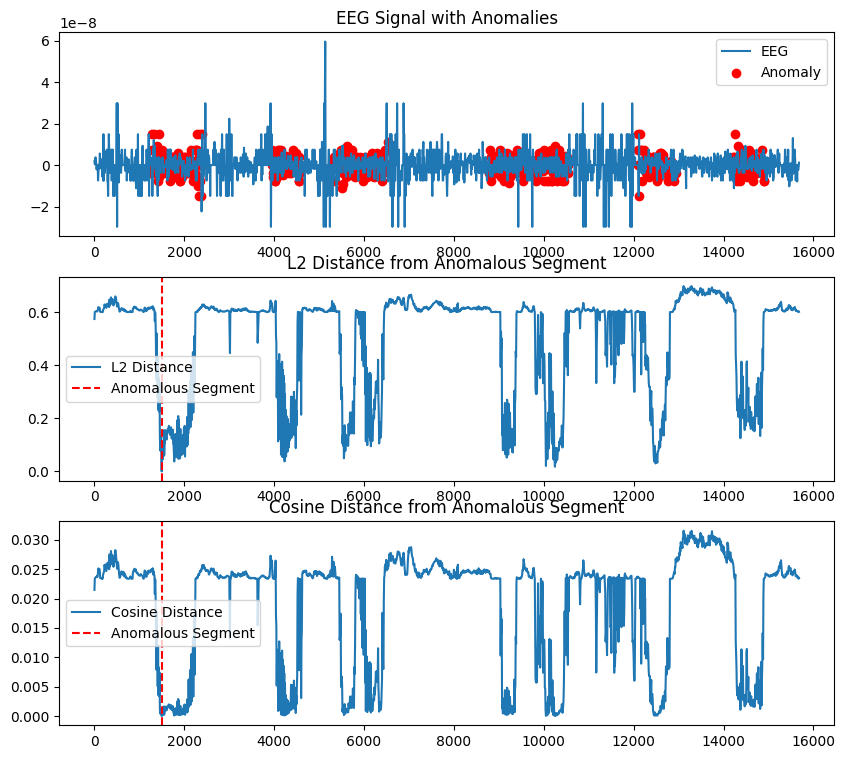

In [206]:
plot_eeg_and_distances(eeg_segments, labels, l2_distances, cosine_distances, anomalous_segment_idx, segment_starts)

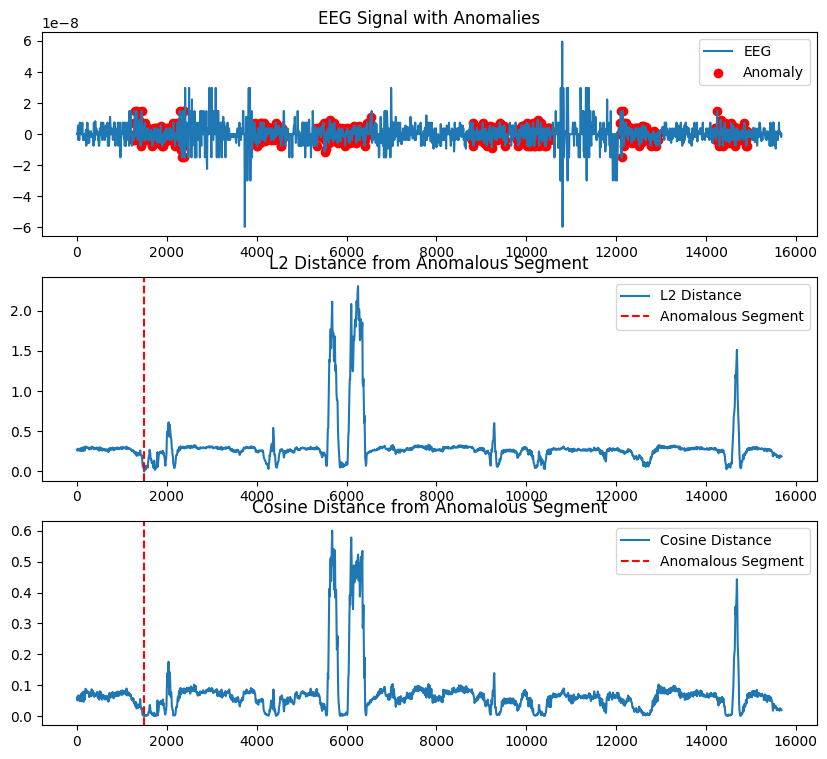

In [188]:
plot_eeg_and_distances(eeg_segments, labels, l2_distances, cosine_distances, anomalous_segment_idx, segment_starts)


In [190]:
cosine_distances[185:190]

array([8.61632658e-03, 6.34657497e-04, 2.83728533e-08, 1.50246059e-04,
       2.98569278e-03])

In [299]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, find_peaks

def bandpass_filter(data, lowcut, highcut, fs, order=4):
    """
    Простейший Баттерворта фильтр в полосе [lowcut, highcut].
    
    data: 1D массив ЭЭГ-сигнала (один канал)
    lowcut, highcut: частоты среза (Гц)
    fs: частота дискретизации (Гц)
    order: порядок фильтра
    """
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    
    b, a = butter(order, [low, high], btype='band')
    filtered_data = filtfilt(b, a, data)
    return filtered_data


def detect_sharp_waves(data, fs, threshold, min_duration_ms=20, max_duration_ms=80):
    """
    Детекция «острых» волн (sharp waves) методом поиска пиков по порогу
    и длительности.
    
    threshold: амплитудный порог
    min_duration_ms, max_duration_ms: допустимые границы длительности (в мс)
    
    Возвращает:
    - valid_peaks: массив индексов обнаруженных пиков, удовлетворяющих условиям.
    """
    # Первоначально находим пики, превышающие порог
    # peaks_w, peak_props_w = find_peaks(data, prominence=threshold)
    
    # Для оценки длительности используем ширину пика на уровне половинной амплитуды
    peaks_w, peak_props_w = find_peaks(data, prominence=threshold, width=1, rel_height=0.5)
    
    min_samples = (min_duration_ms / 1000.) * fs
    max_samples = (max_duration_ms / 1000.) * fs
    
    valid_peaks = []
    # Проходимся по всем найденным пикам и отбираем те, у которых ширина в отсчетах соответствует диапазону.
    for i, peak in enumerate(peaks_w):
        width_in_samples = peak_props_w['widths'][i]
        if (width_in_samples >= min_samples) and (width_in_samples <= max_samples):
            valid_peaks.append(peak)
    
    return np.array(valid_peaks, dtype=int)


def detect_slow_waves(data, fs, threshold, min_duration_ms=100, max_duration_ms=500):
    """
    Детекция «медленных» волн (slow waves).
    
    threshold: амплитудный порог
    min_duration_ms, max_duration_ms: допустимый диапазон длительности (мс)
    
    Возвращает:
    - valid_peaks: массив индексов обнаруженных пиков, соответствующих критериям.
    """
    # Поиск пиков, превышающих порог
    # peaks_w, peak_props_w = find_peaks(data, prominence=threshold)
    
    # Используем ширину пика на 50% амплитуды для оценки длительности
    peaks_w, peak_props_w = find_peaks(data, prominence=threshold, width=1, rel_height=0.5)
    
    min_samples = (min_duration_ms / 1000.) * fs
    max_samples = (max_duration_ms / 1000.) * fs
    
    valid_peaks = []
    for i, peak in enumerate(peaks_w):
        width_in_samples = peak_props_w['widths'][i]
        if (width_in_samples >= min_samples) and (width_in_samples <= max_samples):
            valid_peaks.append(peak)
    
    return np.array(valid_peaks, dtype=int)


def process_multichannel_eeg(eeg_data, fs):
    """
    Обработка многоканальных ЭЭГ-данных.
    
    eeg_data: матрица с размерностью [n_channels, n_samples]
    fs: частота дискретизации (Гц)
    
    На каждом канале применяем фильтрацию и детекцию sharp и slow волн.
    Возвращаем словарь с результатами для каждого канала.
    """
    # Задайте параметры фильтрации
    lowcut = 0.5
    highcut = 40
    
    # Параметры детекции. Возможна индивидуальная настройка для каждого типа волн.
    sharp_threshold = 5
    slow_threshold = 50

    results = {}
    n_channels = eeg_data.shape[0]
    
    for ch in range(n_channels):
        # Получаем данные конкретного канала
        data = eeg_data[ch, :]
        
        # Фильтрация сигнала для текущего канала
        filt_data = bandpass_filter(data, lowcut, highcut, fs, order=4)
        
        # Детектируем sharp и slow волны
        sharp_peaks = detect_sharp_waves(filt_data, fs,
                                         threshold=sharp_threshold,
                                         min_duration_ms=5, 
                                         max_duration_ms=100)
        
        slow_peaks = detect_slow_waves(filt_data, fs,
                                       threshold=slow_threshold,
                                       min_duration_ms=100, 
                                       max_duration_ms=400)
        # Сохраняем результаты для текущего канала
        results[ch] = {
            'filtered_data': filt_data,
            'sharp_peaks': sharp_peaks,
            'slow_peaks': slow_peaks
        }
    
    return results




In [300]:
def demo_multichannel_from_data(eeg_data, fs, selected_channels=[0, 5]):
    """
    Демонстрация обработки данных на основе уже считанного массива ЭЭГ.
    
    eeg_data: np.ndarray с размерностью [n_channels, n_samples]
    fs: частота дискретизации (Гц)
    selected_channels: список индексов каналов, которые нужно отобразить
    """
    assert eeg_data.ndim == 2, "eeg_data должен быть матрицей [n_channels, n_samples]"
    
    n_channels, n_samples = eeg_data.shape
    t = np.arange(n_samples) / fs
    
    # Обработка всех каналов
    results = process_multichannel_eeg(eeg_data, fs)
    
    # Визуализация выбранных каналов
    plt.figure(figsize=(15, 5 * len(selected_channels)))
    
    for idx, ch in enumerate(selected_channels):
        filt_data = results[ch]['filtered_data']
        sharp_peaks = results[ch]['sharp_peaks']
        slow_peaks = results[ch]['slow_peaks']
        
        plt.subplot(len(selected_channels), 1, idx+1)
        plt.plot(t, filt_data, label=f'Канал {ch}')
        if len(sharp_peaks):
            plt.plot(t[sharp_peaks], filt_data[sharp_peaks], 'ro', label='Sharp waves')
        if len(slow_peaks):
            plt.plot(t[slow_peaks], filt_data[slow_peaks], 'go', label='Slow waves')
        plt.xlabel('Время, с')
        plt.ylabel('Амплитуда')
        plt.legend()
        plt.title(f'Обработка канала {ch}')
    
    plt.tight_layout()
    plt.show()


/var/folders/6h/dmx_4ypx4lj10g44gy2qxfdc0000gn/T/ipykernel_7665/3850633044.py:2: RuntimeWarning: Omitted 30 annotation(s) that were outside data range.
  test_raw = mne.io.read_raw_eeglab('/Users/egorperelygin/тестовые/new_file_combined_by3_thr=02.set',preload=True)


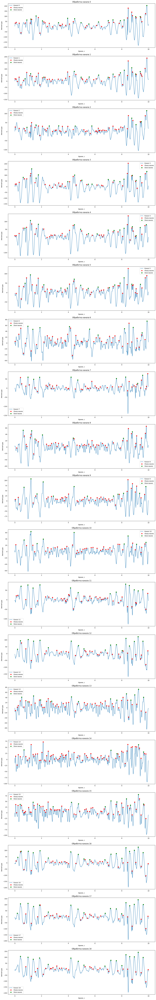

In [301]:
# Пример: eeg_data — это np.ndarray с формой (19, 5000)
test_raw = mne.io.read_raw_eeglab('/Users/egorperelygin/тестовые/new_file_combined_by3_thr=02.set',preload=True)
eeg_data = test_raw.get_data()[:,:1000]*1000*1000
fs = 100  # ваша частота дискретизации
selected_channels = np.arange(0,19)
demo_multichannel_from_data(eeg_data, fs, selected_channels=selected_channels)
